In [22]:
import pandas as pd
import numpy as np

#'''Seaborn and Matplotlib Visualization'''
import matplotlib                  # 2D Plotting Library
import matplotlib.pyplot as plt
import seaborn as sns              # Python Data Visualization Library based on matplotlib
plt.style.use('fivethirtyeight')
%matplotlib inline

#'''Plotly Visualizations'''
import plotly as plotly                # Interactive Graphing Library for Python
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.offline as py
init_notebook_mode(connected=True)
import os
%pylab inline
import re

import warnings
warnings.filterwarnings('ignore')


Populating the interactive namespace from numpy and matplotlib


In [23]:
data = pd.read_csv('CDC_CLEANED.csv')

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,denial_reason-2,denial_reason-3,denial_reason-4,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_owner_occupied_units,tract_one_to_four_family_homes,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,NaN,NaN,NaN,7063,68.84,70700,84,2053,2733,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,NaN,NaN,NaN,7063,68.84,70700,84,2053,2733,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,NaN,NaN,NaN,4746,46.46,56500,73,1068,1969,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,NaN,NaN,NaN,3162,47.53,54700,79,761,1416,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,NaN,NaN,NaN,4162,69.46,51600,74,920,1872,40


In [25]:
data.dropna(inplace = True, thresh = 250000, axis = 1)

In [26]:
data.shape

(594769, 43)

In [27]:
data.columns

Index(['county_code', 'census_tract', 'conforming_loan_limit',
       'derived_loan_product_type', 'derived_ethnicity', 'derived_race',
       'derived_sex', 'action_taken', 'purchaser_type', 'preapproval',
       'loan_type', 'loan_purpose', 'open-end_line_of_credit',
       'business_or_commercial_purpose', 'loan_amount', 'loan_to_value_ratio',
       'interest_rate', 'rate_spread', 'total_loan_costs',
       'origination_charges', 'loan_term', 'interest_only_payment',
       'property_value', 'occupancy_type', 'total_units', 'income',
       'debt_to_income_ratio', 'co-applicant_credit_score_type',
       'applicant_ethnicity-1', 'co-applicant_ethnicity-1', 'applicant_race-1',
       'co-applicant_race-1', 'applicant_age', 'co-applicant_age',
       'applicant_age_above_62', 'denial_reason-1', 'tract_population',
       'tract_minority_population_percent',
       'ffiec_msa_md_median_family_income', 'tract_to_msa_income_percentage',
       'tract_owner_occupied_units', 'tract_one_to

In [28]:
data.drop(['open-end_line_of_credit', 'rate_spread', 'total_loan_costs', 'origination_charges',
        'loan_term', 'interest_only_payment',
       'co-applicant_credit_score_type',
       'applicant_ethnicity-1', 'co-applicant_ethnicity-1', 'applicant_race-1',
       'co-applicant_race-1', 'co-applicant_age','applicant_age_above_62'], inplace = True, axis =1)

In [29]:
data.head()

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,debt_to_income_ratio,applicant_age,denial_reason-1,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_owner_occupied_units,tract_one_to_four_family_homes,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,20%-<30%,55-64,7,4746,46.46,56500,73,1068,1969,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,NaN,25-34,10,3162,47.53,54700,79,761,1416,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,38,45-54,10,4162,69.46,51600,74,920,1872,40


In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

In [31]:
data.dtypes

county_code                          float64
census_tract                         float64
conforming_loan_limit                 object
derived_loan_product_type             object
derived_ethnicity                     object
derived_race                          object
derived_sex                           object
action_taken                           int64
purchaser_type                         int64
preapproval                            int64
loan_type                              int64
loan_purpose                           int64
business_or_commercial_purpose         int64
loan_amount                          float64
loan_to_value_ratio                   object
interest_rate                         object
property_value                        object
occupancy_type                         int64
total_units                            int64
income                               float64
debt_to_income_ratio                  object
applicant_age                         object
denial_rea

In [32]:
data.head()

,county_code,census_tract,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,action_taken,purchaser_type,preapproval,...,debt_to_income_ratio,applicant_age,denial_reason-1,tract_population,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage,tract_owner_occupied_units,tract_one_to_four_family_homes,tract_median_age_of_housing_units
0,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
1,37119.0,3.711901e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,2,0,2,...,20%-<30%,55-64,10,7063,68.84,70700,84,2053,2733,15
2,37085.0,3.708507e+10,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,3,0,2,...,20%-<30%,55-64,7,4746,46.46,56500,73,1068,1969,44
3,37065.0,3.706502e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,4,0,2,...,NaN,25-34,10,3162,47.53,54700,79,761,1416,38
4,37185.0,3.718595e+10,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,8,2,...,38,45-54,10,4162,69.46,51600,74,920,1872,40


In [33]:
data.drop(['tract_owner_occupied_units', 'tract_one_to_four_family_homes','tract_median_age_of_housing_units','tract_population','total_units','business_or_commercial_purpose','preapproval','purchaser_type','action_taken','total_units','tract_population','census_tract']
          , axis =1, inplace = True)

In [34]:
data.head()

,county_code,conforming_loan_limit,derived_loan_product_type,derived_ethnicity,derived_race,derived_sex,loan_type,loan_purpose,loan_amount,loan_to_value_ratio,interest_rate,property_value,occupancy_type,income,debt_to_income_ratio,applicant_age,denial_reason-1,tract_minority_population_percent,ffiec_msa_md_median_family_income,tract_to_msa_income_percentage
0,37119.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,1,1,35000.0,NaN,6.5,55000,1,51.0,20%-<30%,55-64,10,68.84,70700,84
1,37119.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Joint,1,1,35000.0,NaN,6.5,55000,1,51.0,20%-<30%,55-64,10,68.84,70700,84
2,37085.0,C,Conventional:First Lien,Hispanic or Latino,Race Not Available,Male,1,1,45000.0,NaN,NaN,NaN,1,36.0,20%-<30%,55-64,7,46.46,56500,73
3,37065.0,C,Conventional:First Lien,Not Hispanic or Latino,White,Male,1,1,15000.0,NaN,NaN,NaN,1,39.0,NaN,25-34,10,47.53,54700,79
4,37185.0,C,Conventional:First Lien,Not Hispanic or Latino,White,Joint,1,1,25000.0,NaN,9.95,NaN,1,92.0,38,45-54,10,69.46,51600,74


In [35]:
data.shape

(594769, 20)

In [36]:
data.dtypes

county_code                          float64
conforming_loan_limit                 object
derived_loan_product_type             object
derived_ethnicity                     object
derived_race                          object
derived_sex                           object
loan_type                              int64
loan_purpose                           int64
loan_amount                          float64
loan_to_value_ratio                   object
interest_rate                         object
property_value                        object
occupancy_type                         int64
income                               float64
debt_to_income_ratio                  object
applicant_age                         object
denial_reason-1                        int64
tract_minority_population_percent    float64
ffiec_msa_md_median_family_income      int64
tract_to_msa_income_percentage         int64
dtype: object

ValueError: could not convert string to float: 'Exempt'

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), <a list of 9 Text xticklabel objects>)

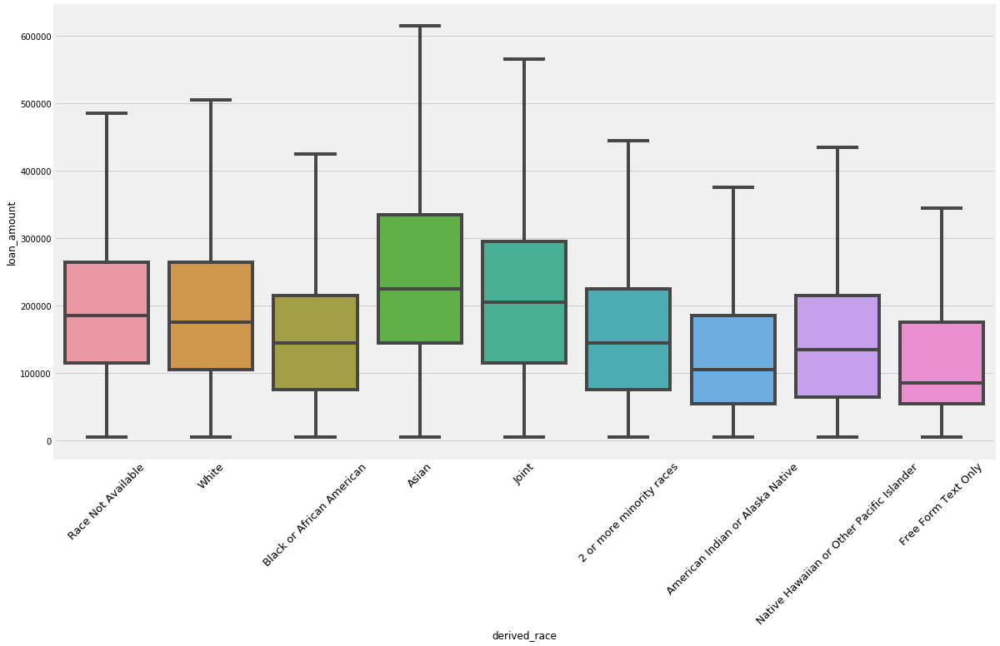

In [63]:
#SeaBorn BoxPlot: derived_race vs. loan_amount

plt.rcParams['figure.figsize'] = (18,10)
sns.boxplot(x = 'derived_race', y = 'loan_amount', data = data, showfliers = False)
plt.xticks(rotation = 45, size = 13)

(array([0, 1, 2, 3, 4]), <a list of 5 Text xticklabel objects>)

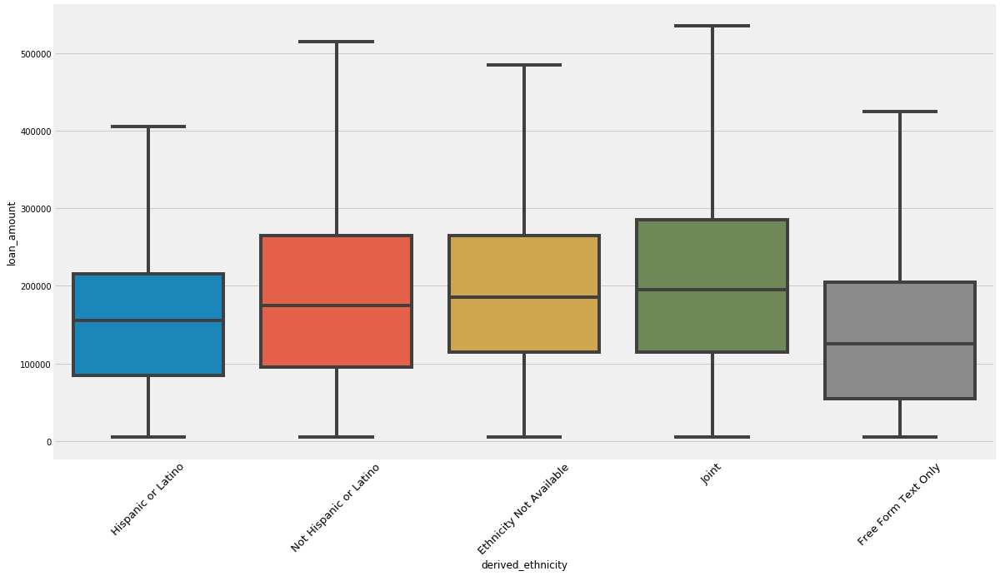

In [62]:
#SeaBorn BoxPlot: derived_ethnicity vs. loan_amount

plt.rcParams['figure.figsize'] = (18,10)
sns.boxplot(x = 'derived_ethnicity', y = 'loan_amount', data = data, showfliers = False)
plt.xticks(rotation = 45, size = 13)

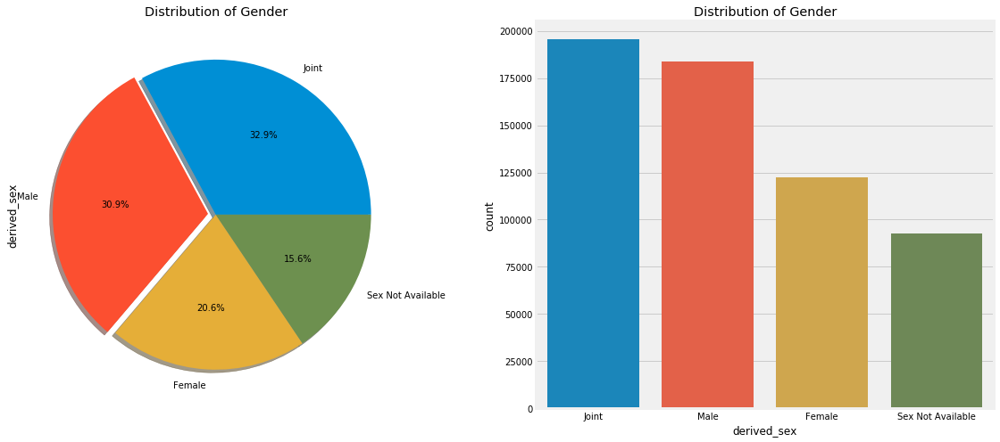

In [38]:
#Seaborn: Age Distribution

f,ax=plt.subplots(1,2,figsize=(18,8))

data['derived_sex'].value_counts().plot.pie(explode=[0,0.05,0,0],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Distribution of Gender')

sns.countplot('derived_sex',data=data,ax=ax[1])
ax[1].set_title('Distribution of Gender')
plt.show()

In [18]:
#Plotly Derived Race Distributions

labels = sorted(data.derived_race.unique())
values = data.derived_race.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']



fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+percent', textinfo='value',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Race")
fig.show()

In [19]:
#Plotly: Derived Ethnicity Distribution

labels = sorted(data.derived_ethnicity.unique())
values = data.derived_ethnicity.value_counts().sort_index()
colors = ['DarkGrey', 'HotPink']


fig = go.Figure(data=[go.Pie(labels=labels,
                             values=values, pull=[0, 0.06])])
fig.update_traces(hoverinfo='label+percent', textinfo='value',textfont_size=20,
                  marker=dict(colors=colors, line=dict(color='#000000', width=2)))

fig.update_layout(title_text="Distribution of Derived Ethnicity")
fig.show()

In [20]:
#Plotly: Conforming Loan Limit - Gender

ccl_c = data[data['conforming_loan_limit'] == 'C']
ccl_nc = data[data['conforming_loan_limit'] == 'NC']
ccl_u = data[data['conforming_loan_limit'] == 'U']

trace1 = go.Histogram(
    x=ccl_c.derived_sex,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='LightSeaGreen',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_sex,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_sex,
    opacity=0.85,
    name = "Not Survived",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))

plotdata = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - GENDER',
                   xaxis=dict(title='GENDER'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=plotdata, layout=layout)
iplot(fig)

In [21]:
#Plotly: Conforming Loan Limit - Derived Race

trace1 = go.Histogram(
    x=ccl_c.derived_race,
    opacity=0.85,
    name = "Conforming",
    marker=dict(color='DodgerBlue',line=dict(color='#000000', width=2)))
trace2 = go.Histogram(
    x=ccl_nc.derived_race,
    opacity=0.85,
    name = "Not Conforming",
    marker=dict(color='Crimson',line=dict(color='#000000', width=2)))
trace3 = go.Histogram(
    x=ccl_u.derived_race,
    opacity=0.85,
    name = "Not Survived",
    marker=dict(color='Coral',line=dict(color='#000000', width=2)))



plotdata = [trace1, trace2, trace3]
layout = go.Layout(barmode='stack',
                   title='Conforming Loan Limit - RACE',
                   xaxis=dict(title='RACE'),
                   yaxis=dict( title='COUNT'),
                   template = 'plotly_dark'
)
fig = go.Figure(data=plotdata, layout=layout)
iplot(fig)

In [ ]:
new_data = data[pd.notnull(data['county_code'])]
fin_data = new_data.copy()

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_selector as selector

numeric_features = ['income', 'loan_amount', 'tract_minority_population_percent']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = ['applicant_age', 'derived_sex', 'derived_race', 'derived_ethnicity', 'loan_type', 'county_code', 'denial_reason-1']

categorical_transformer = Pipeline(steps=[
    ('encoder', OrdinalEncoder()),
    #('imputer', SimpleImputer(strategy='constant', fill_value='mode')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
     ])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, selector(dtype_exclude='object')),
    ('cat', categorical_transformer, selector(dtype_include='object'))
    ])

total_features = ['income', 'loan_amount', 'tract_minority_population_percent', 'applicant_age', 'derived_sex', 'derived_race', 'derived_ethnicity', 'loan_type', 'county_code', 'denial_reason-1']

In [ ]:
preprocessor.fit_transform(fin_data[total_features])